## Image Segmentation

In [1]:
from transformers.utils import logging

logging.set_verbosity_error()

### What is Segmentation Mask Generation?

In the image, we simply performed image segmentation on the image that you can see. The model predicts pixel-wise labes for each pixel of the image with corresponding label of the pixel. 

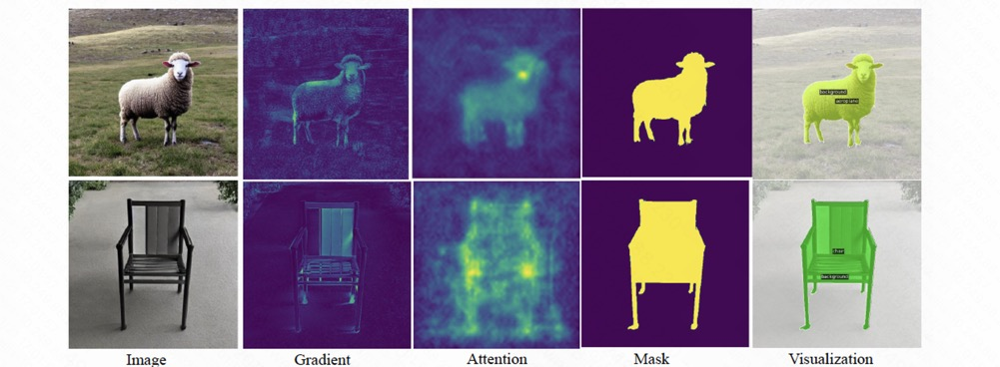


Mask generation optionally takes input 2D points and / or bounding boxes and does not output the class of the mask.

它会生成一个掩码(mask)，但不会告诉你这是只“猫”还是个“沙发”。

如果你想知道这个区域是什么，你需要再加一个分类器去判断。

### Segment Anything Model (SAM)

a groundbreaking model for segmentation mask generation

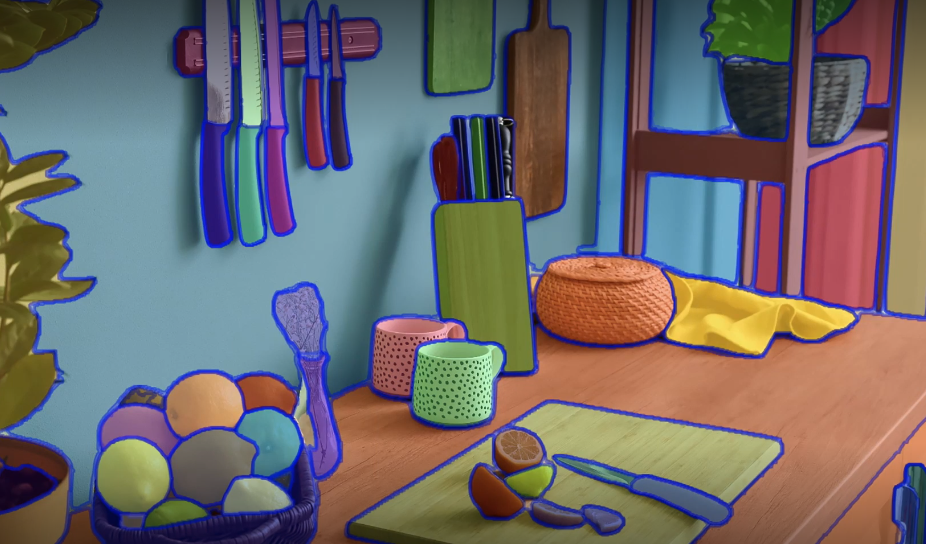

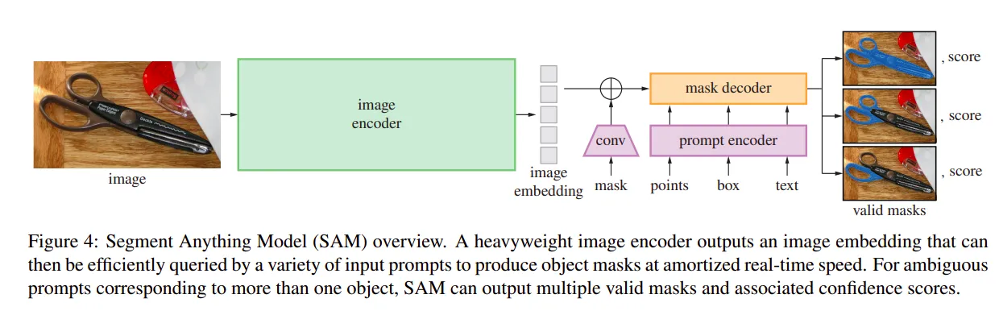


In hugging face, they are going to use a distilled compressed version of the model called Slim SAM, which basically does the same thing as SAM with similar performances, but it is much smaller. 

So this model is going to be useful for us because we are going to run our task on a small hardware. Wo we will be able to run a segment anything model without need of having a high compute requirement. https://arxiv.org/html/2312.05284v2

In [43]:
from transformers import pipeline

sam_pipe = pipeline("mask-generation",
                   "Zigeng/SlimSAM-uniform-77", 
                    device= -1
                   )

In [44]:
# sam_pipe.device = torch.device("cpu") 

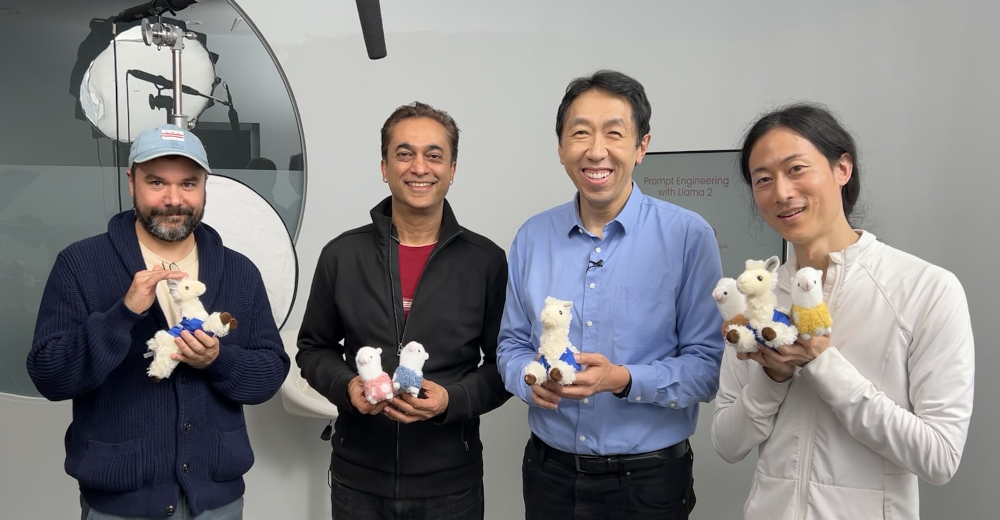

In [45]:
from PIL import Image

raw_image = Image.open('meta_llamas.jpg')
raw_image

In [46]:
output = sam_pipe(raw_image, points_per_batch = 32)

In [53]:
import matplotlib.pyplot as plt

def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3),
                                np.array([0.6])],
                               axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

In [54]:
def show_pipe_masks_on_image(raw_image, outputs):
  plt.imshow(np.array(raw_image))
  ax = plt.gca()
  for mask in outputs["masks"]:
      show_mask(mask, ax=ax, random_color=True)
  plt.axis("off")
  plt.show()

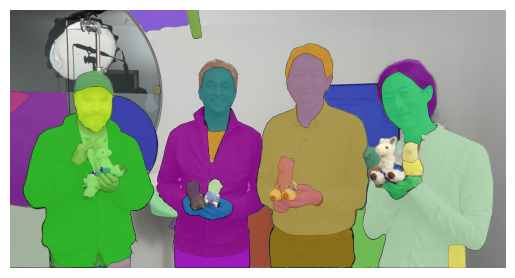

In [55]:
show_pipe_masks_on_image(raw_image, output)

As you can see, the model was able to segment all small regions of interest in the whole picture. 

For example, it was able to segment all the heads regions for each person, was able to segment almost all the llamas individually themeselves, also the clothes. And we have got a lot of different effects on the model. 

The problem with this pipeline is that you need to iterate over all the points and post-process the generated masks, which might be a bit show for some use cases and applications. 

So we are going to focus on one specific use case where we were going to infer the model with an image and a single point. 

In [56]:
from transformers import SamModel, SamProcessor

model = SamModel.from_pretrained(
    "Zigeng/SlimSam-uniform-77"
)

processor = SamProcessor.from_pretrained(
    "Zigeng/SlimSam-uniform-77"
)

In [57]:
model

SamModel(
  (shared_image_embedding): SamPositionalEmbedding()
  (vision_encoder): SamVisionEncoder(
    (patch_embed): SamPatchEmbeddings(
      (projection): Conv2d(3, 168, kernel_size=(16, 16), stride=(16, 16))
    )
    (layers): ModuleList(
      (0-11): 12 x SamVisionLayer(
        (layer_norm1): LayerNorm((168,), eps=1e-06, elementwise_affine=True)
        (attn): SamVisionAttention(
          (qkv): Linear(in_features=168, out_features=504, bias=True)
          (proj): Linear(in_features=168, out_features=168, bias=True)
        )
        (layer_norm2): LayerNorm((168,), eps=1e-06, elementwise_affine=True)
        (mlp): SamMLPBlock(
          (lin1): Linear(in_features=168, out_features=696, bias=True)
          (lin2): Linear(in_features=696, out_features=168, bias=True)
          (act): GELUActivation()
        )
      )
    )
    (neck): SamVisionNeck(
      (conv1): Conv2d(168, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (layer_norm1): SamLayerNorm()
      (c

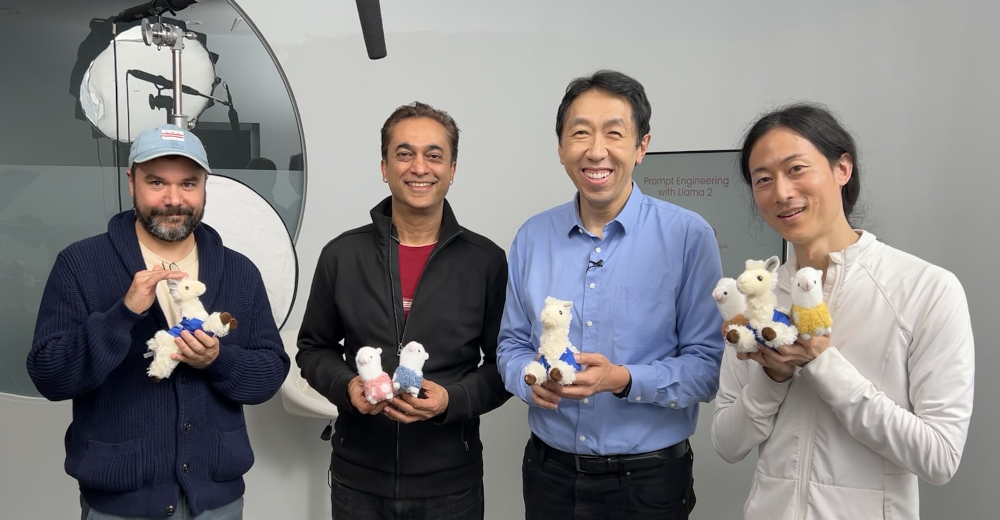

In [58]:
raw_image

In [59]:
input_points = [[[1600, 700]]]

In [60]:
inputs = processor(
    raw_image,
    input_points = input_points,
    return_tensors = "pt"
)

In [62]:
import torch

with torch.no_grad():
    outputs = model(**inputs)

In [63]:
predicted_masks = processor.image_processor.post_process_masks(
    outputs.pred_masks,
    inputs["original_sizes"],
    inputs["reshaped_input_sizes"]
)

In [64]:
len(predicted_masks)

1

In [65]:
predicted_masks = predicted_masks[0]
predicted_masks.shape

torch.Size([1, 3, 1500, 2880])

In [66]:
outputs.iou_scores

tensor([[[0.9583, 0.9551, 0.9580]]])

In [67]:
def show_mask_on_image(raw_image, mask, return_image=False):
    if not isinstance(mask, torch.Tensor):
      mask = torch.Tensor(mask)

    if len(mask.shape) == 4:
      mask = mask.squeeze()

    fig, axes = plt.subplots(1, 1, figsize=(15, 15))

    mask = mask.cpu().detach()
    axes.imshow(np.array(raw_image))
    show_mask(mask, axes)
    axes.axis("off")
    plt.show()

    if return_image:
      fig = plt.gcf()
      return fig2img(fig)

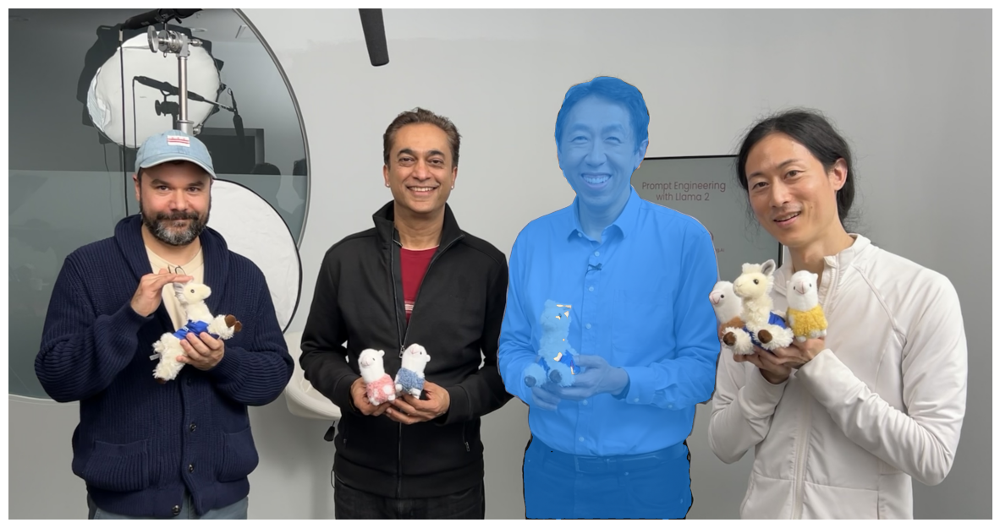

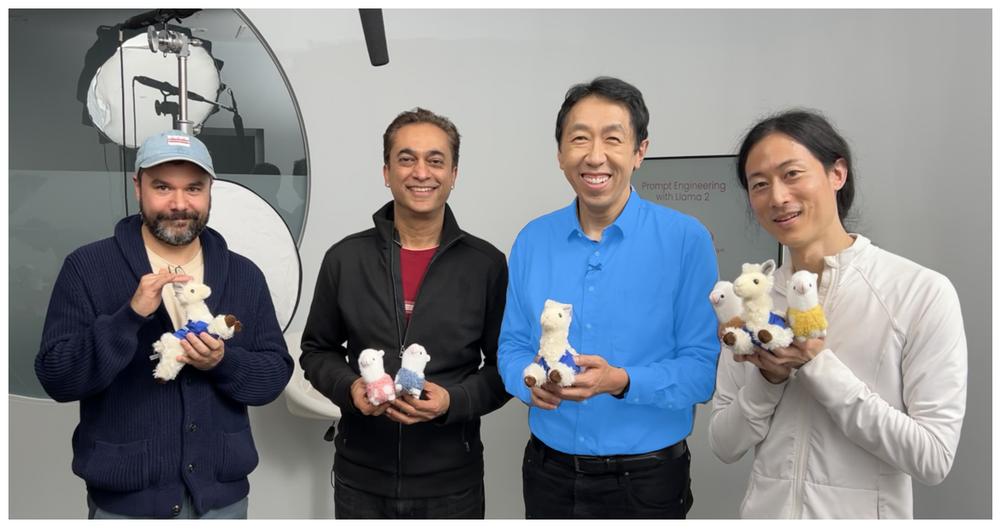

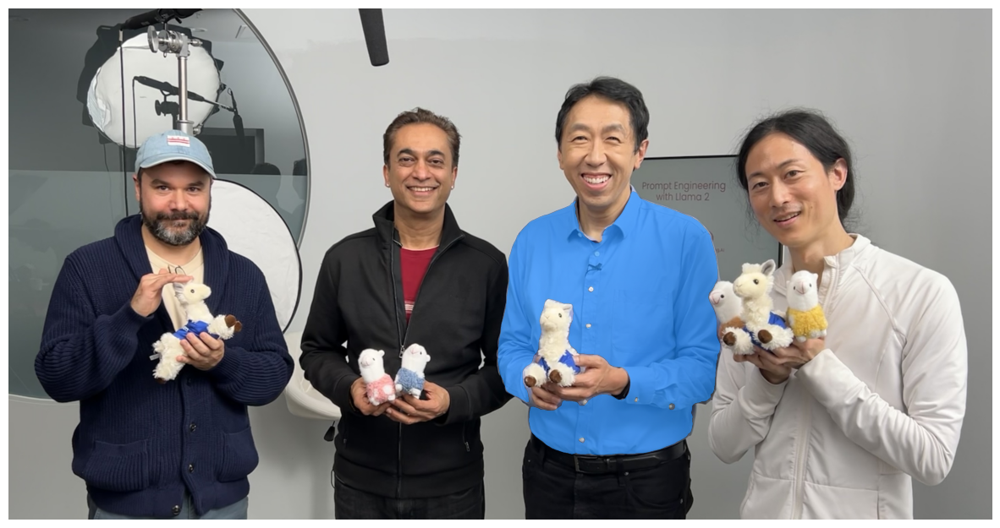

In [68]:
for i in range(3):
    show_mask_on_image(raw_image, predicted_masks[:, i])

Now that we have seen how to use the segment anything model in order to segment object of interest given an image and some 2D corrdinates and or bounding boxes. I wanted to also present you another model called **DPT**, which stands for dense prediction transformer. 

So **DPT** is a model that you can use to perform depth estimation given an image.

**Depth Estimation** is a common task in computer vision. That is also why they used, for example in autonomous driving. 

🔹 Segment Anything Model (SAM)

- 用来分割图像中的目标
- 只需要提供 2D 坐标或 bounding box 就能高效工作
- 适合做交互式图像处理，比如点击一个点就分出对象，体验感很强！

🔹 Dense Prediction Transformer (DPT)

- DPT = Dense Prediction Transformer
- 任务是 depth estimation：预测图像中每个像素离摄像头的距离
- 在自动驾驶等需要空间感知的应用里非常重要
- 不再依赖 CNN，而是用 Transformer 做像素级的预测，思路很新颖

In [70]:
from transformers import pipeline

depth_estimator = pipeline(
    task = "depth-estimation",
    model = "Intel/dpt-hybrid-midas")

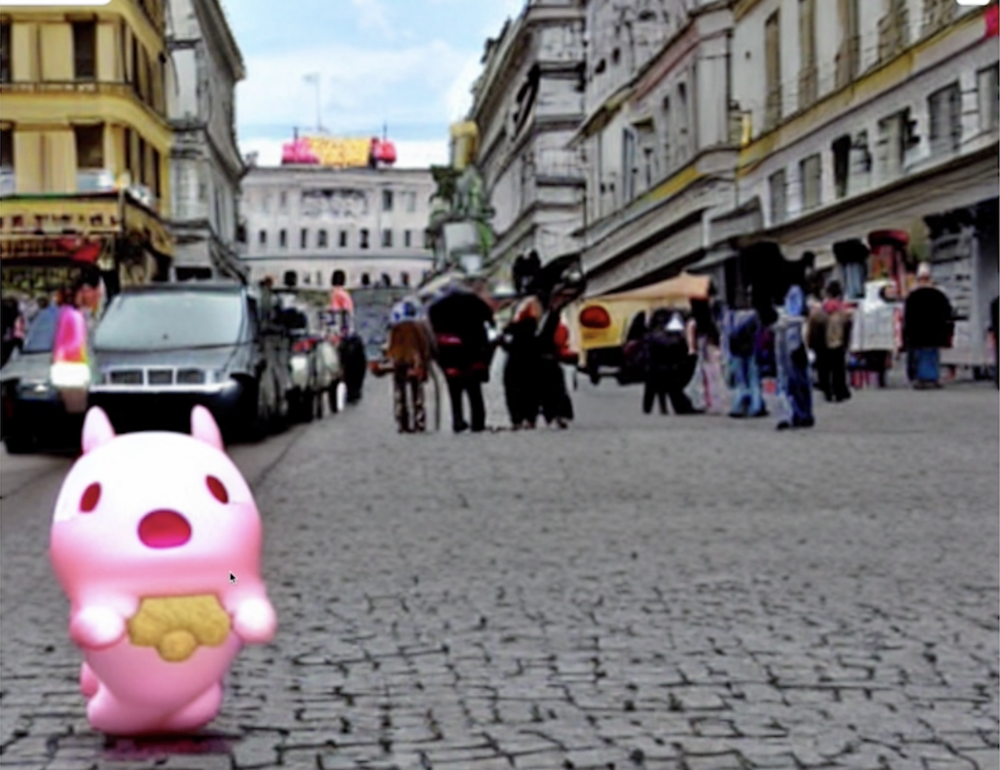

In [71]:
raw_image = Image.open('gradio_tamagochi_vienna.png')
raw_image

In [77]:
output = depth_estimator(raw_image)

In [78]:
output

{'predicted_depth': tensor([[ 248.1576,  248.2613,  248.7575,  ...,  468.0612,  447.0020,
           442.8537],
         [ 248.0308,  248.1443,  248.6917,  ...,  477.7599,  458.3914,
           454.5754],
         [ 247.0835,  247.2385,  247.9991,  ...,  508.8517,  494.9483,
           492.2065],
         ...,
         [3040.0322, 3040.3923, 3042.2261,  ..., 3285.1125, 3283.1304,
          3282.7407],
         [3037.8643, 3038.3806, 3041.0227,  ..., 3288.0479, 3286.3186,
          3285.9739],
         [3037.5449, 3038.1074, 3040.9893,  ..., 3289.0525, 3287.3730,
          3287.0369]]),
 'depth': <PIL.Image.Image image mode=L size=1612x1242>}

In [79]:
output["predicted_depth"].shape

torch.Size([1242, 1612])

In [80]:
output["predicted_depth"].unsqueeze(1).shape

torch.Size([1242, 1, 1612])

In [81]:
import torch

prediction = torch.nn.functional.interpolate(
    output["predicted_depth"].unsqueeze(0).unsqueeze(0),
    size = raw_image.size[::-1],
    mode = "bicubic",
    align_corners=False
).squeeze(0).squeeze(0)

In [83]:
prediction.shape

torch.Size([1242, 1612])

In [84]:
raw_image.size[::-1]

(1242, 1612)

In [85]:
prediction

tensor([[ 248.1576,  248.2613,  248.7575,  ...,  468.0612,  447.0020,
          442.8537],
        [ 248.0308,  248.1443,  248.6917,  ...,  477.7599,  458.3914,
          454.5754],
        [ 247.0835,  247.2385,  247.9991,  ...,  508.8517,  494.9483,
          492.2065],
        ...,
        [3040.0322, 3040.3923, 3042.2261,  ..., 3285.1125, 3283.1304,
         3282.7407],
        [3037.8643, 3038.3806, 3041.0227,  ..., 3288.0479, 3286.3186,
         3285.9739],
        [3037.5449, 3038.1074, 3040.9893,  ..., 3289.0525, 3287.3730,
         3287.0369]])

In [87]:
import numpy as np 

output = prediction.squeeze().numpy()
formatted = (output * 255 / np.max(output)).astype("uint8")
depth = Image.fromarray(formatted)

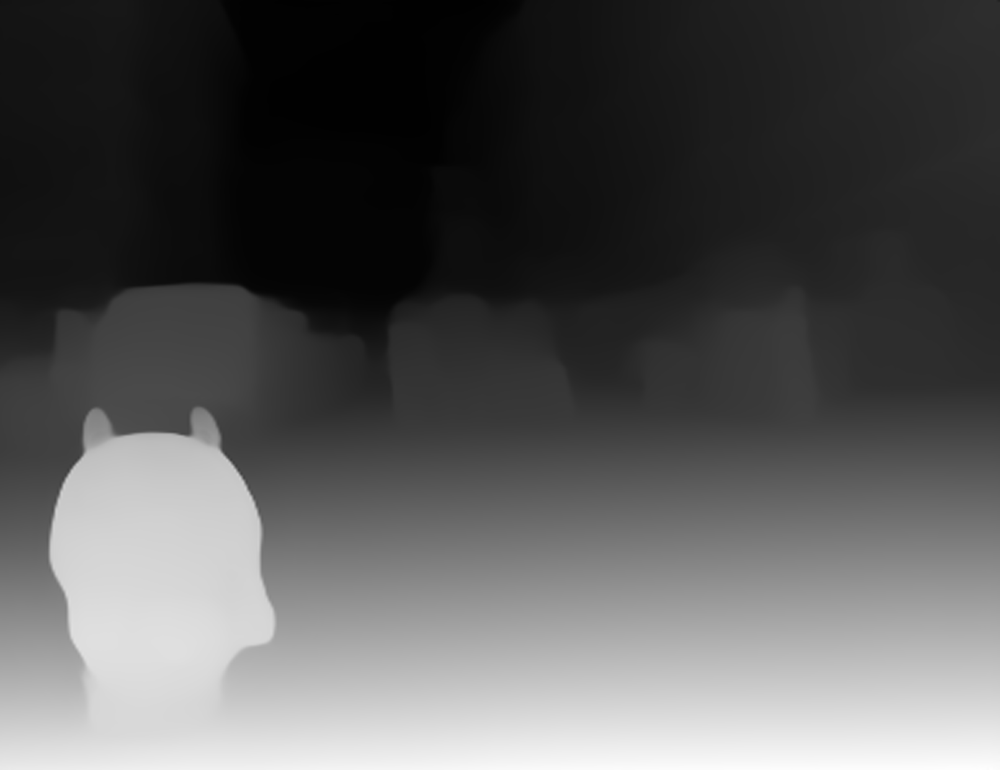

In [88]:
depth

In [102]:
import gradio as gr
from transformers import pipeline
import torch
import numpy as np

def launch(input_image):
    output = depth_estimator(input_image)

    # resize the prediction
    prediction = torch.nn.functional.interpolate(
        output["predicted_depth"].unsqueeze(0).unsqueeze(0),
        size = input_image.size[::-1],
        mode = "bicubic",
        align_corners=False
    ).squeeze(0).squeeze(0)

    # normalize the prediction 
    output = prediction.squeeze().numpy()
    formatted = (output * 255 / np.max(output)).astype("uint8")
    depth = Image.fromarray(formatted)

    return depth

In [103]:
iface = gr.Interface(launch,
                    inputs = gr.Image(type = "pil"),
                    outputs= gr.Image(type = "pil"))

In [104]:
iface.launch(share=True)

* Running on local URL:  http://127.0.0.1:7864
* Running on public URL: https://2c6e0737fb9b936b19.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)
